# 3. Fitting diads once you have groups
- Once you have divided your diads into groups based on strengths, you need to tweak the fit parameters for each group
- Then you can loop through all files in a given group and automatically fit the spectra

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import joblib
import DiadFit as pf
pf.__version__

'0.0.77'

## Specifying filetype, and folder as before

In [2]:
# This specifies what file type your Raman exported in. 
meta_path, spectra_path, filetype, prefix, prefix_str, file_ext, TruPower=pf.get_settings()

## Load in data and fit parameters
- This loads in the dataframes of the fit parameters you saved in the other file, by group
- At this point you select what group you want to fit (batch = 'Weak', 'Medium' or 'Strong'). After running through the entire notebook for one group, come back up here to fit a second group.

In [6]:
## load dataframes and numpy arrays 
np_x = joblib.load('np_x.sav')

# Select the group you want to fit ('Weak', 'Medium', 'Strong')
batch='Strong' # Options are Weak, Medium, Strong

if batch=='Weak':
    GroupN_df=joblib.load('Weak_df.sav')
if batch=='Medium':
    GroupN_df=joblib.load('Medium_df.sav')
if batch=='Strong':
    GroupN_df=joblib.load('Strong_df.sav')

### Now load one file from this group to tweak parameters for

In [7]:
Diad_Files =GroupN_df['filename']
i=0


### Lets plot the diad to have a look at it

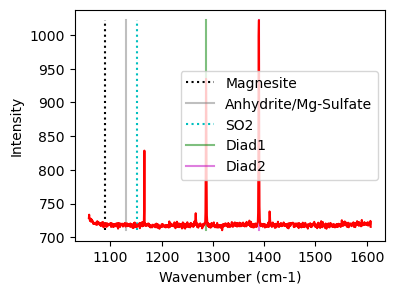

In [8]:
plot1=pf.plot_diad(path=spectra_path, filename=Diad_Files[i], filetype=filetype)

## Now lets inspect the diads and get their approximate positions
- As with generic peak, you can exclude 2 segments (e.g. around cosmic rays)
- You then specify how many peaks you want to fit on each diad. 1 means just the strong peak, 2 hotbands, and 3 for Diad2 would also fit the C13 peak if present. 
- The identify_diad_peaks then uses scipy findpeaks to identify the positions of the 2 diads, and any other peaks the user asks for. These are saved, and fed into the later functions for peak fitting. 

## Choose a model for fitting all peaks
- Option of Voigt or PseudoVoigt. We recomend PsuedoVoigt

In [9]:
model_name='PseudoVoigtModel'

## Fit Diad 1
- Tweak the parameters in the config files for each group. E.g. how many peaks (fit_peaks), the background positions, the sigma of the diad, and whether or not you want a gaussian background

In [10]:
diad_id_config=pf.diad_id_config(height=50, exclude_range1=[1308, 1309])
diad_id_config

if batch=='Weak':
    diad1_fit_config_init=pf.diad1_fit_config(
    model_name=model_name, fit_peaks=2,
    N_poly_bck_diad1=2, lower_bck_diad1=(1180, 1250),
    upper_bck_diad1=(1300, 1350),
    diad_sigma=0.6,
    x_range_residual=10, x_range_baseline=30, 
     y_range_baseline=100, 
    HB_prom=GroupN_df['HB1_abs_prom'].iloc[i], 
    diad_prom=GroupN_df['Diad1_abs_prom'].iloc[i])
    diad1_fit_config_init

if batch=='Medium':
    diad1_fit_config_init=pf.diad1_fit_config(
    model_name=model_name, fit_peaks=2,
    N_poly_bck_diad1=2, lower_bck_diad1=(1180, 1240),
    upper_bck_diad1=(1315, 1350),
    diad_sigma=0.6,
    x_range_residual=10, x_range_baseline=30, 
     y_range_baseline=100, 
    HB_prom=GroupN_df['HB1_abs_prom'].iloc[i], 
    diad_prom=GroupN_df['Diad1_abs_prom'].iloc[i])
    diad1_fit_config_init

if batch=='Strong':
    diad1_fit_config_init=pf.diad1_fit_config(
    fit_gauss=True, gauss_amp= 2*GroupN_df['HB1_abs_prom'].iloc[i],
    model_name=model_name, fit_peaks=2,
    N_poly_bck_diad1=1, lower_bck_diad1=(1180, 1220),
    upper_bck_diad1=(1330, 1350),
    diad_sigma=0.6,
    x_range_residual=10, x_range_baseline=30, 
     y_range_baseline=1000, 
    HB_prom=GroupN_df['HB1_abs_prom'].iloc[i], 
    diad_prom=GroupN_df['Diad1_abs_prom'].iloc[i])
diad1_fit_config_init

diad1_fit_config(model_name='PseudoVoigtModel', fit_peaks=2, N_poly_bck_diad1=1, lower_bck_diad1=(1180, 1220), upper_bck_diad1=(1330, 1350), fit_gauss=True, gauss_amp=37.23469114710133, diad_sigma=0.6, diad_sigma_min_allowance=0.2, diad_sigma_max_allowance=5, diad_prom=222.00998863690825, HB_prom=18.617345573550665, x_range_baseline=30, y_range_baseline=1000, dpi=200, x_range_residual=10, return_other_params=False)

### See what these fit parameters look like for diad1

,Diad1_Combofit_Cent,Diad1_Voigt_Cent,Diad1_cent_err,Diad1_Voigt_Area,Diad1_Voigt_Sigma,Diad1_Voigt_Gamma,HB1_Cent,HB1_Area,HB1_Sigma,Diad1_Combofit_Height,Diad1_Residual,Diad1_Prop_Lor,Diad1_fwhm,Diad1_Gauss_Cent,Diad1_Gauss_Area,Diad1_Gauss_Sigma,Diad1_refit
0,1286.621153,1286.621203,0.005771,334.42861,0.634382,0,1266.280696,29.979398,0.584018,224.170094,1.801847,0.294124,1.268764,1279.654664,0.372348,6.339688,Flagged Warnings:


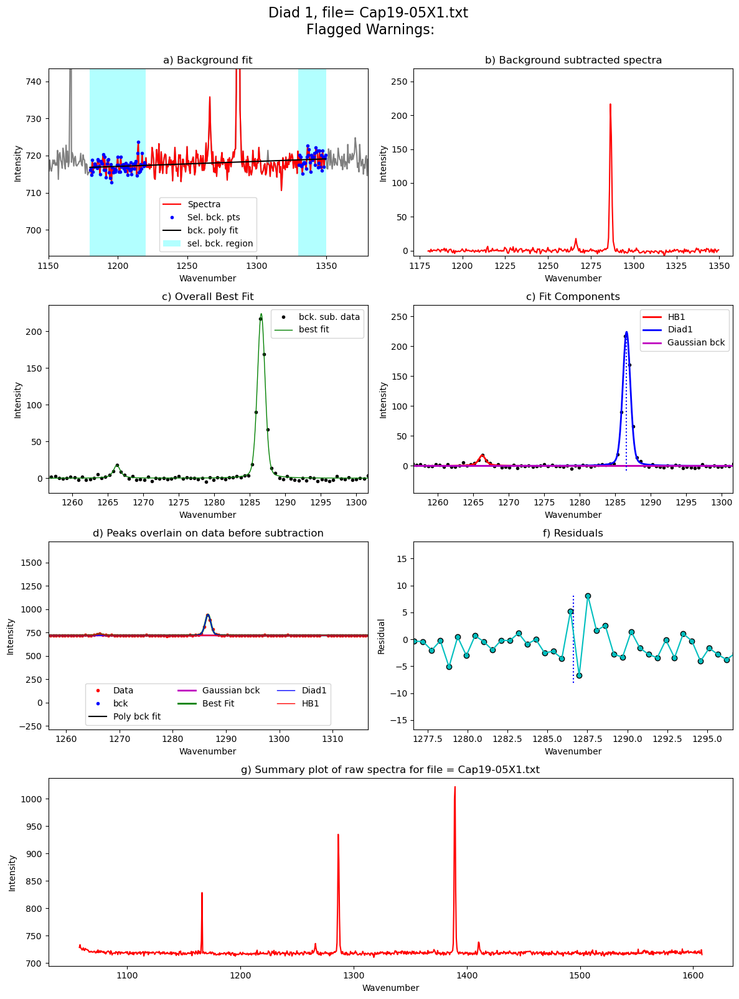

In [11]:
Diad1_fit=pf.fit_diad_1_w_bck(config1=diad1_fit_config_init,
config2=diad_id_config,
path=spectra_path, filename=Diad_Files.iloc[0],
filetype=filetype, plot_figure=True, close_figure=False,
Diad_pos=GroupN_df['Diad1_pos'].iloc[i],
HB_pos=GroupN_df['HB1_pos'].iloc[i])
Diad1_fit

### Update the sigma
- The sigma parameter varies quite a lot based on the splitting. Best to update your first guess with what you found for the example file above

In [12]:
diad1_fit_config2=diad1_fit_config_init

## Fit diad2

In [13]:
if batch=='Weak':
    diad2_fit_config_init=pf.diad2_fit_config(model_name=model_name,
    fit_peaks=2, upper_bck_diad2=(1430, 1480),
    lower_bck_diad2=(1310, 1360), diad_sigma=0.4,  N_poly_bck_diad2=1,                                       
    x_range_residual=30, y_range_baseline=100,  
    x_range_baseline=30,
    HB_prom=GroupN_df['HB2_abs_prom'].iloc[i], 
    diad_prom=GroupN_df['Diad2_abs_prom'].iloc[i])
    diad2_fit_config_init

if batch=='Medium':
    diad2_fit_config_init=pf.diad2_fit_config(model_name=model_name,
    fit_peaks=3, fit_gauss=True, gauss_amp= 2*GroupN_df['HB2_abs_prom'].iloc[i],
    lower_bck_diad2=(1310, 1350), diad_sigma=1,  N_poly_bck_diad2=2,                                       
    x_range_residual=30, y_range_baseline=100,  
    x_range_baseline=30,
    HB_prom=GroupN_df['HB2_abs_prom'].iloc[i], 
    diad_prom=GroupN_df['Diad2_abs_prom'].iloc[i],
    C13_prom=GroupN_df['C13_abs_prom'].iloc[i])
    diad2_fit_config_init

if batch=='Strong':
    diad2_fit_config_init=pf.diad2_fit_config(model_name=model_name,
    fit_peaks=3, fit_gauss=True, gauss_amp= 2*GroupN_df['HB2_abs_prom'].iloc[i],
    lower_bck_diad2=(1310, 1340), diad_sigma=1,  N_poly_bck_diad2=2,                                       
    x_range_residual=30, y_range_baseline=1000,  
    x_range_baseline=30,
    HB_prom=GroupN_df['HB2_abs_prom'].iloc[i], 
    diad_prom=GroupN_df['Diad2_abs_prom'].iloc[i],
    C13_prom=GroupN_df['C13_abs_prom'].iloc[i])
    diad2_fit_config_init
diad2_fit_config_init

diad2_fit_config(model_name='PseudoVoigtModel', fit_peaks=3, N_poly_bck_diad2=2, lower_bck_diad2=(1310, 1340), upper_bck_diad2=(1440, 1470), fit_gauss=True, gauss_amp=41.40630793837681, diad_sigma=1, diad_sigma_min_allowance=0.2, diad_sigma_max_allowance=5, diad_prom=325.9289412519447, HB_prom=20.703153969188406, x_range_baseline=30, y_range_baseline=1000, plot_figure=True, dpi=200, x_range_residual=30, return_other_params=False, C13_prom=nan)

### See what these fit parameters look like for diad2

,Diad2_Combofit_Cent,Diad2_Voigt_Cent,Diad2_cent_err,Diad2_Voigt_Area,Diad2_Voigt_Sigma,Diad2_Voigt_Gamma,HB2_Cent,HB2_Area,HB2_Sigma,Diad2_Combofit_Height,Diad2_Residual,Diad2_Prop_Lor,Diad2_fwhm,Diad2_Gauss_Cent,Diad2_Gauss_Area,Diad2_Gauss_Sigma,Diad2_refit
0,1389.4267,1389.42675,0.003807,455.604833,0.609287,0,1410.605412,25.390744,0.584525,333.276783,1.910686,0.15875,1.218573,1382.454299,0.414063,15.224817,Flagged Warnings:


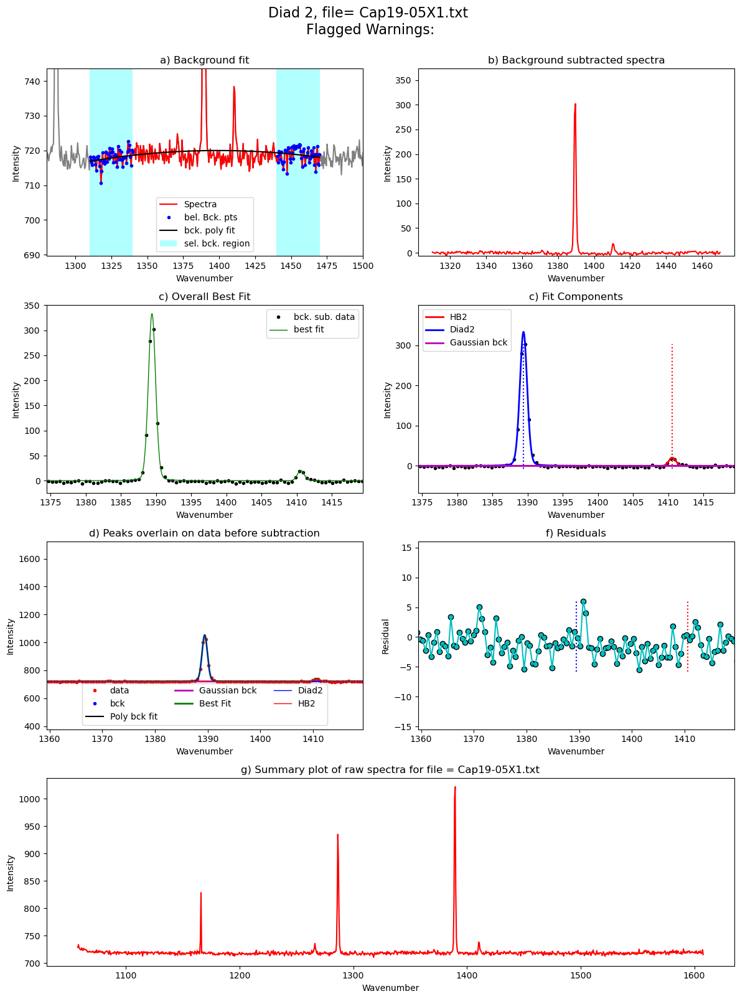

In [14]:
Diad2_fit=pf.fit_diad_2_w_bck(config1=diad2_fit_config_init,
    config2=diad_id_config,
path=spectra_path, filename=Diad_Files[i], filetype=filetype,
plot_figure=True, close_figure=False, 
Diad_pos=GroupN_df['Diad2_pos'].iloc[i],
HB_pos=GroupN_df['HB2_pos'].iloc[i], 
C13_pos=GroupN_df['C13_pos'].iloc[i])
Diad2_fit.to_clipboard(excel=True)
Diad2_fit

## Loop over all the files in the group
- This will loop over all the 

  0%|                                                                                           | 0/77 [00:00<?, ?it/s]

Processing file: Cap19-05X1.txt


  1%|█                                                                                  | 1/77 [00:04<05:27,  4.31s/it]

Processing file: Cap19-05X2_CRR_DiadFit.txt


  3%|██▏                                                                                | 2/77 [00:09<05:42,  4.57s/it]

Processing file: Cap19-06X1.txt


  4%|███▏                                                                               | 3/77 [00:12<05:04,  4.12s/it]

Processing file: Cap19-06X2.txt


  5%|████▎                                                                              | 4/77 [00:16<04:57,  4.08s/it]

Processing file: Cap19-07X1.txt


  6%|█████▍                                                                             | 5/77 [00:19<04:14,  3.53s/it]

Processing file: Cap19-07X2_CRR_DiadFit.txt


  8%|██████▍                                                                            | 6/77 [00:21<03:51,  3.26s/it]

Processing file: Cap19-08X1_CRR_DiadFit.txt


  9%|███████▌                                                                           | 7/77 [00:24<03:40,  3.15s/it]

Processing file: Cap19-08X2.txt


 10%|████████▌                                                                          | 8/77 [00:27<03:27,  3.01s/it]

Processing file: Cap19-12X1.txt


 12%|█████████▋                                                                         | 9/77 [00:30<03:29,  3.09s/it]

Processing file: Cap19-12X2.txt


 13%|██████████▋                                                                       | 10/77 [00:34<03:35,  3.22s/it]

Processing file: Cap19-17X1.txt


c:\users\penny\box\berkeley_new\diadfit_outer\src\DiadFit\diads.py:2976: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig,axes=plt.subplot_mosaic(mosaic=figure_mosaic, figsize=(12, 16))
 14%|███████████▋                                                                      | 11/77 [00:37<03:24,  3.10s/it]

Processing file: Cap19-17X2_CRR_DiadFit.txt


 16%|████████████▊                                                                     | 12/77 [00:40<03:26,  3.18s/it]

Processing file: Cap19-18X1.txt


 17%|█████████████▊                                                                    | 13/77 [00:46<04:18,  4.04s/it]

Processing file: Cap19-18X2.txt


 18%|██████████████▉                                                                   | 14/77 [00:49<04:00,  3.82s/it]

Processing file: FG04_31_MI.txt


 19%|███████████████▉                                                                  | 15/77 [00:52<03:31,  3.42s/it]

Processing file: FG04_31_MI3 (1)_CRR_DiadFit.txt


 21%|█████████████████                                                                 | 16/77 [00:55<03:18,  3.26s/it]

Processing file: FG04_31_MI3.txt


 22%|██████████████████                                                                | 17/77 [00:58<03:11,  3.19s/it]

Processing file: FG04_31_MI4 (1).txt


 23%|███████████████████▏                                                              | 18/77 [01:01<03:15,  3.32s/it]

Processing file: FG04_31_MI4.txt


 25%|████████████████████▏                                                             | 19/77 [01:05<03:15,  3.37s/it]

Processing file: POC1.txt


 26%|█████████████████████▎                                                            | 20/77 [01:09<03:24,  3.59s/it]

Processing file: POC10.txt


 27%|██████████████████████▎                                                           | 21/77 [01:14<03:47,  4.05s/it]

Processing file: POC11.txt
refit attempt 1


 29%|███████████████████████▍                                                          | 22/77 [01:17<03:31,  3.84s/it]

Processing file: POC12_CRR_DiadFit.txt
refit attempt 1


 30%|████████████████████████▍                                                         | 23/77 [01:21<03:19,  3.70s/it]

Processing file: POC13.txt


 31%|█████████████████████████▌                                                        | 24/77 [01:25<03:16,  3.71s/it]

Processing file: POC14.txt
refit attempt 1


 32%|██████████████████████████▌                                                       | 25/77 [01:29<03:27,  3.99s/it]

Processing file: POC15.txt
refit attempt 1


 34%|███████████████████████████▋                                                      | 26/77 [01:34<03:32,  4.17s/it]

Processing file: POC16.txt
refit attempt 1


 35%|████████████████████████████▊                                                     | 27/77 [01:37<03:15,  3.92s/it]

Processing file: POC17.txt
refit attempt 1


 36%|█████████████████████████████▊                                                    | 28/77 [01:41<03:04,  3.76s/it]

Processing file: POC18.txt
refit attempt 1


 38%|██████████████████████████████▉                                                   | 29/77 [01:44<03:02,  3.80s/it]

Processing file: POC19.txt


 39%|███████████████████████████████▉                                                  | 30/77 [01:48<03:00,  3.85s/it]

Processing file: POC2.txt


 40%|█████████████████████████████████                                                 | 31/77 [01:53<03:10,  4.14s/it]

Processing file: POC20.txt


 42%|██████████████████████████████████                                                | 32/77 [01:56<02:54,  3.88s/it]

Processing file: POC21.txt


 43%|███████████████████████████████████▏                                              | 33/77 [02:00<02:48,  3.83s/it]

Processing file: POC22_CRR_DiadFit.txt


 44%|████████████████████████████████████▏                                             | 34/77 [02:03<02:33,  3.57s/it]

Processing file: POC23.txt


 45%|█████████████████████████████████████▎                                            | 35/77 [02:06<02:22,  3.39s/it]

Processing file: POC24.txt


 47%|██████████████████████████████████████▎                                           | 36/77 [02:09<02:11,  3.22s/it]

Processing file: POC25_CRR_DiadFit.txt


 48%|███████████████████████████████████████▍                                          | 37/77 [02:12<02:06,  3.16s/it]

Processing file: POC26.txt
refit attempt 1


 49%|████████████████████████████████████████▍                                         | 38/77 [02:16<02:09,  3.31s/it]

Processing file: POC27_CRR_DiadFit.txt


 51%|█████████████████████████████████████████▌                                        | 39/77 [02:19<02:08,  3.39s/it]

Processing file: POC28.txt


 52%|██████████████████████████████████████████▌                                       | 40/77 [02:23<02:07,  3.44s/it]

Processing file: POC29.txt


 53%|███████████████████████████████████████████▋                                      | 41/77 [02:26<02:02,  3.39s/it]

Processing file: POC3.txt


 55%|████████████████████████████████████████████▋                                     | 42/77 [02:35<02:52,  4.93s/it]

Processing file: POC30.txt


 56%|█████████████████████████████████████████████▊                                    | 43/77 [02:38<02:30,  4.42s/it]

Processing file: POC31.txt


 57%|██████████████████████████████████████████████▊                                   | 44/77 [02:41<02:10,  3.97s/it]

Processing file: POC32.txt


 58%|███████████████████████████████████████████████▉                                  | 45/77 [02:51<03:08,  5.88s/it]

Processing file: POC33.txt


 60%|████████████████████████████████████████████████▉                                 | 46/77 [02:58<03:14,  6.28s/it]

Processing file: POC34.txt


 61%|██████████████████████████████████████████████████                                | 47/77 [03:03<02:52,  5.74s/it]

Processing file: POC35.txt


 62%|███████████████████████████████████████████████████                               | 48/77 [03:06<02:29,  5.14s/it]

Processing file: POC36_CRR_DiadFit.txt


 64%|████████████████████████████████████████████████████▏                             | 49/77 [03:12<02:25,  5.18s/it]

Processing file: POC37.txt


 65%|█████████████████████████████████████████████████████▏                            | 50/77 [03:15<02:04,  4.61s/it]

Processing file: POC38_CRR_DiadFit.txt


 66%|██████████████████████████████████████████████████████▎                           | 51/77 [03:18<01:47,  4.14s/it]

Processing file: POC39_CRR_DiadFit.txt


 68%|███████████████████████████████████████████████████████▍                          | 52/77 [03:21<01:33,  3.75s/it]

Processing file: POC4_CRR_DiadFit.txt


 69%|████████████████████████████████████████████████████████▍                         | 53/77 [03:26<01:40,  4.18s/it]

Processing file: POC40_CRR_DiadFit.txt


 70%|█████████████████████████████████████████████████████████▌                        | 54/77 [03:29<01:30,  3.94s/it]

Processing file: POC41.txt


 71%|██████████████████████████████████████████████████████████▌                       | 55/77 [03:33<01:21,  3.70s/it]

Processing file: POC42.txt


 73%|███████████████████████████████████████████████████████████▋                      | 56/77 [03:36<01:15,  3.59s/it]

Processing file: POC43.txt


 74%|████████████████████████████████████████████████████████████▋                     | 57/77 [03:39<01:07,  3.37s/it]

Processing file: POC44.txt


 75%|█████████████████████████████████████████████████████████████▊                    | 58/77 [03:42<01:01,  3.22s/it]

Processing file: POC45.txt


 77%|██████████████████████████████████████████████████████████████▊                   | 59/77 [03:46<01:01,  3.44s/it]

Processing file: POC46.txt


 78%|███████████████████████████████████████████████████████████████▉                  | 60/77 [03:50<01:01,  3.59s/it]

Processing file: POC47.txt


 79%|████████████████████████████████████████████████████████████████▉                 | 61/77 [03:52<00:53,  3.32s/it]

Processing file: POC48.txt


 81%|██████████████████████████████████████████████████████████████████                | 62/77 [03:55<00:48,  3.24s/it]

Processing file: POC49.txt


 82%|███████████████████████████████████████████████████████████████████               | 63/77 [03:58<00:42,  3.07s/it]

Processing file: POC5.txt
refit attempt 1


 83%|████████████████████████████████████████████████████████████████████▏             | 64/77 [04:03<00:48,  3.73s/it]

Processing file: POC50.txt


 84%|█████████████████████████████████████████████████████████████████████▏            | 65/77 [04:06<00:40,  3.41s/it]

Processing file: POC51.txt


 86%|██████████████████████████████████████████████████████████████████████▎           | 66/77 [04:10<00:40,  3.64s/it]

Processing file: POC52.txt


 87%|███████████████████████████████████████████████████████████████████████▎          | 67/77 [04:14<00:37,  3.76s/it]

Processing file: POC53_CRR_DiadFit.txt


 88%|████████████████████████████████████████████████████████████████████████▍         | 68/77 [04:21<00:41,  4.59s/it]

Processing file: POC54.txt


 90%|█████████████████████████████████████████████████████████████████████████▍        | 69/77 [04:26<00:37,  4.69s/it]

Processing file: POC55.txt


 91%|██████████████████████████████████████████████████████████████████████████▌       | 70/77 [04:31<00:34,  4.94s/it]

Processing file: POC56.txt


 92%|███████████████████████████████████████████████████████████████████████████▌      | 71/77 [04:35<00:28,  4.72s/it]

Processing file: POC57-0.04.txt


 94%|████████████████████████████████████████████████████████████████████████████▋     | 72/77 [04:39<00:22,  4.51s/it]

Processing file: POC58.txt


 95%|█████████████████████████████████████████████████████████████████████████████▋    | 73/77 [04:44<00:18,  4.57s/it]

Processing file: POC6_CRR_DiadFit.txt


 96%|██████████████████████████████████████████████████████████████████████████████▊   | 74/77 [05:00<00:24,  8.11s/it]

Processing file: POC7_CRR_DiadFit.txt
refit attempt 1


 97%|███████████████████████████████████████████████████████████████████████████████▊  | 75/77 [05:06<00:14,  7.36s/it]

Processing file: POC8.txt
refit attempt 1


 99%|████████████████████████████████████████████████████████████████████████████████▉ | 76/77 [05:11<00:06,  6.59s/it]

Processing file: POC9.txt
refit attempt 1


100%|██████████████████████████████████████████████████████████████████████████████████| 77/77 [05:14<00:00,  4.09s/it]


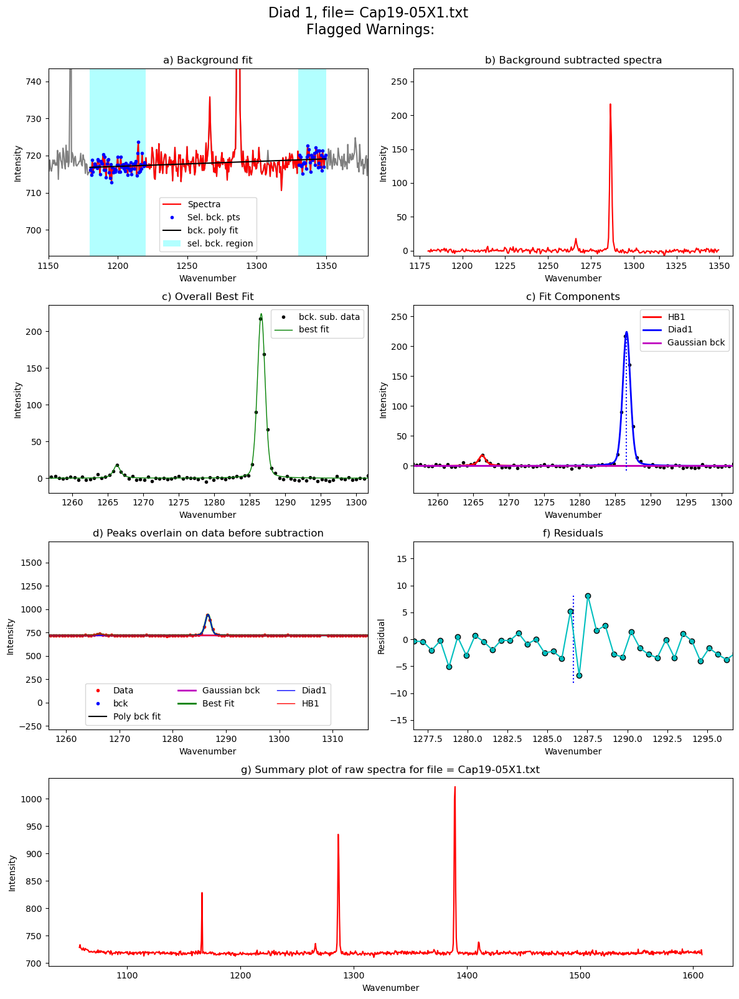

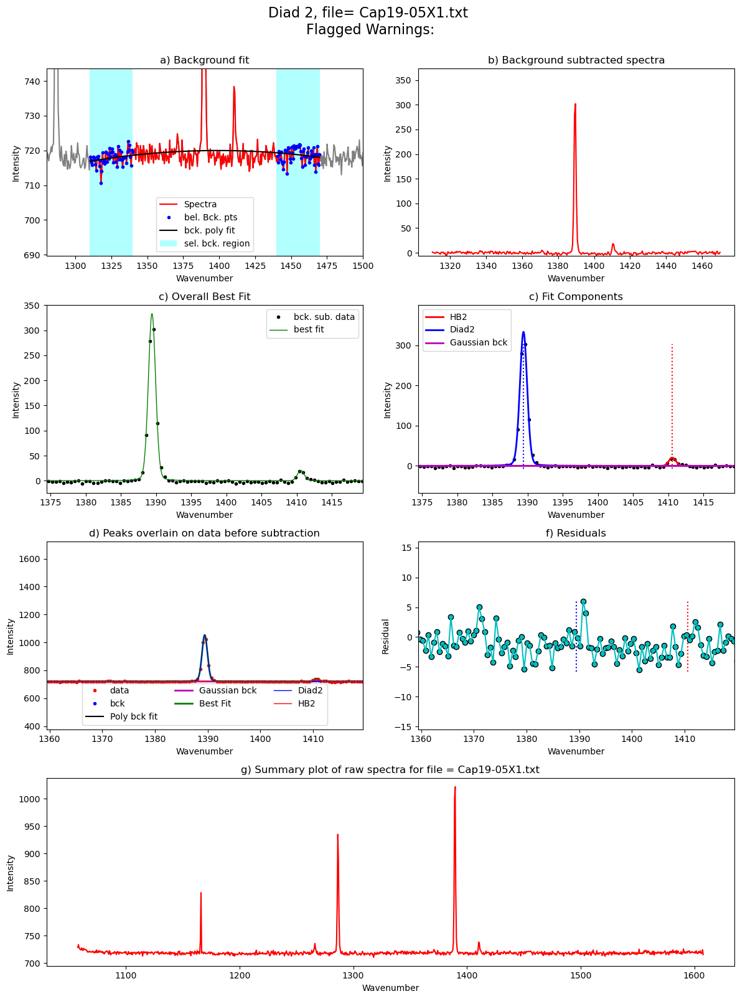

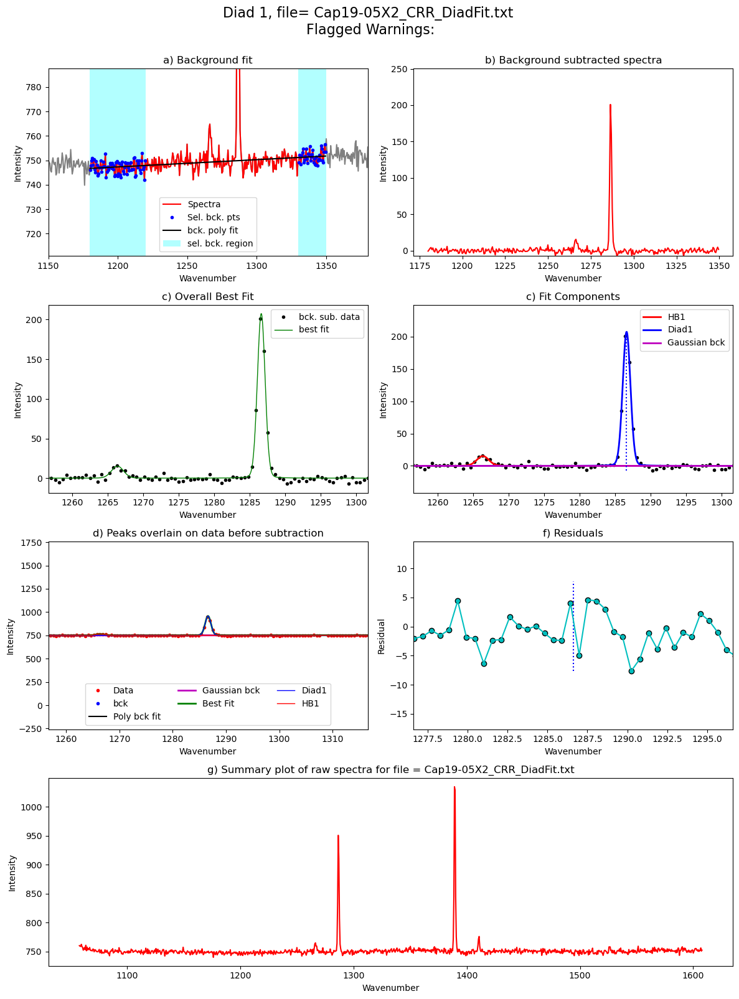

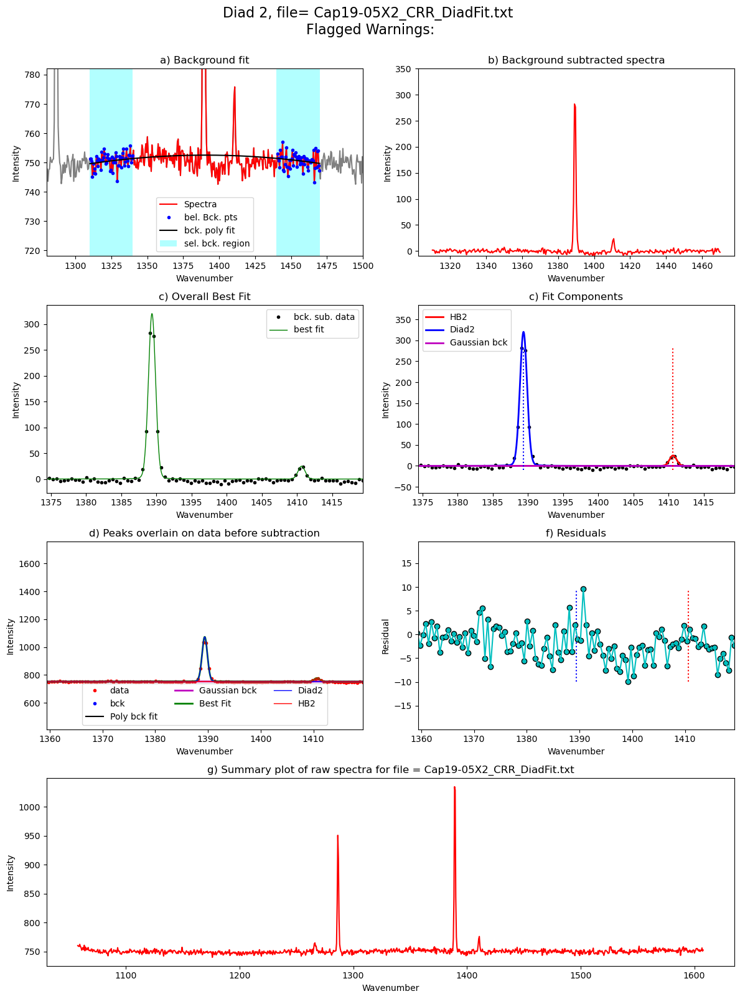

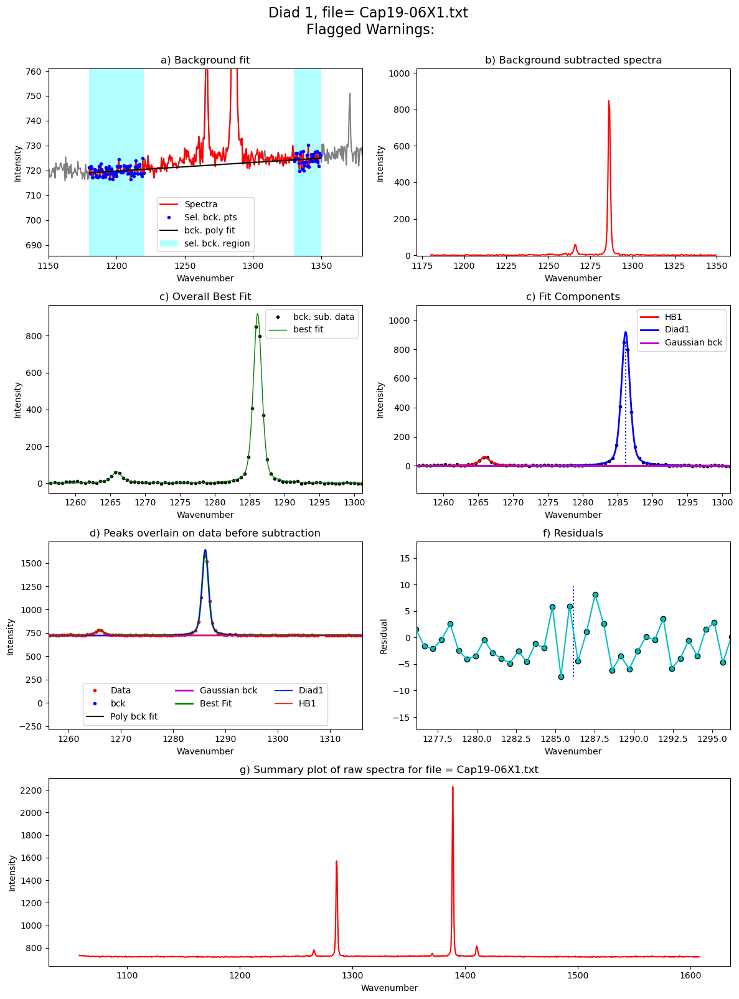

...

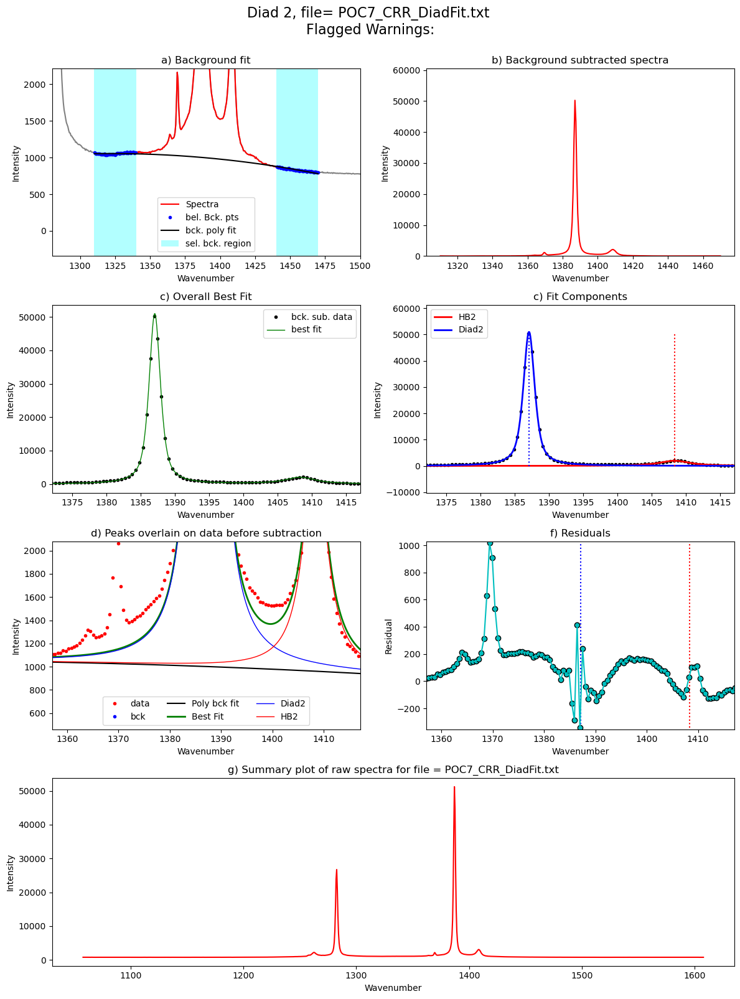

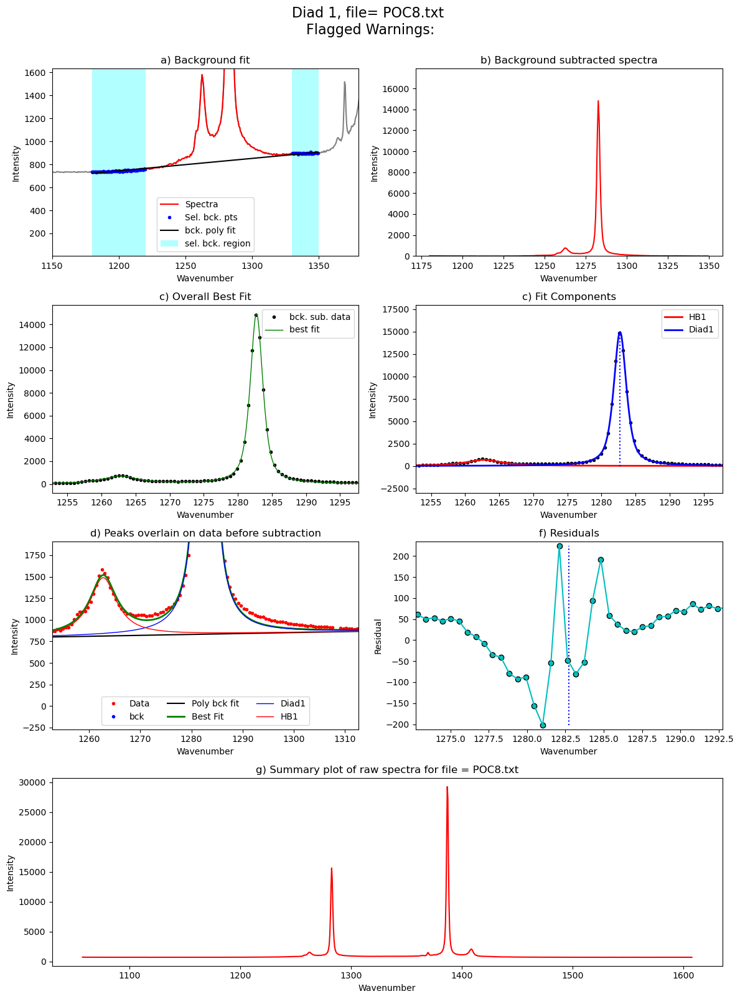

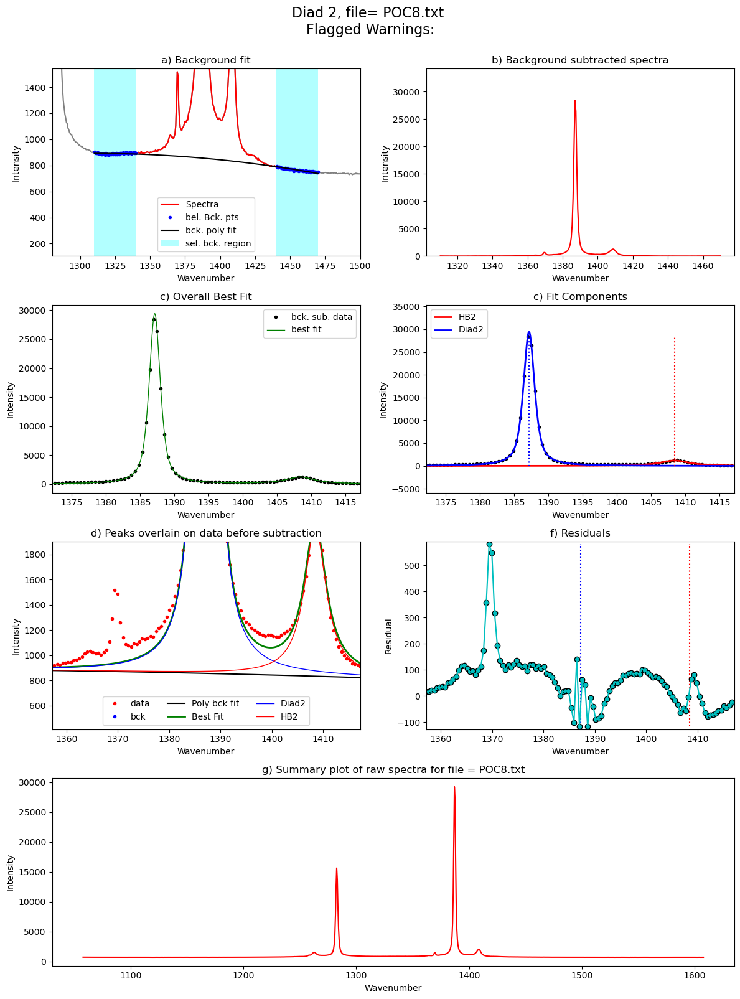

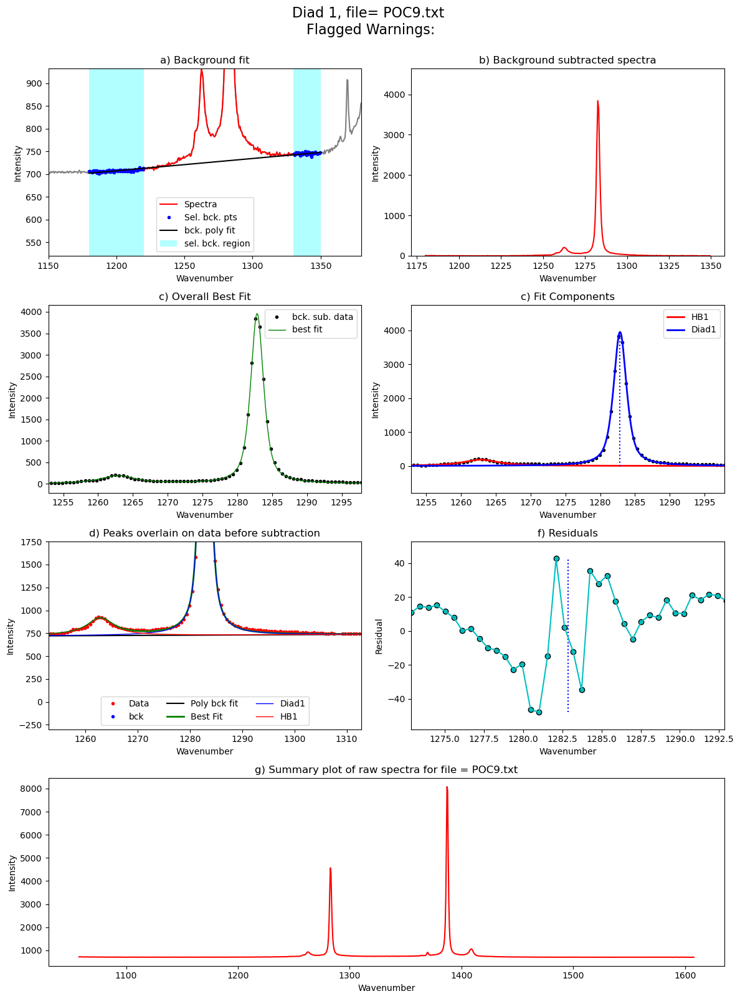

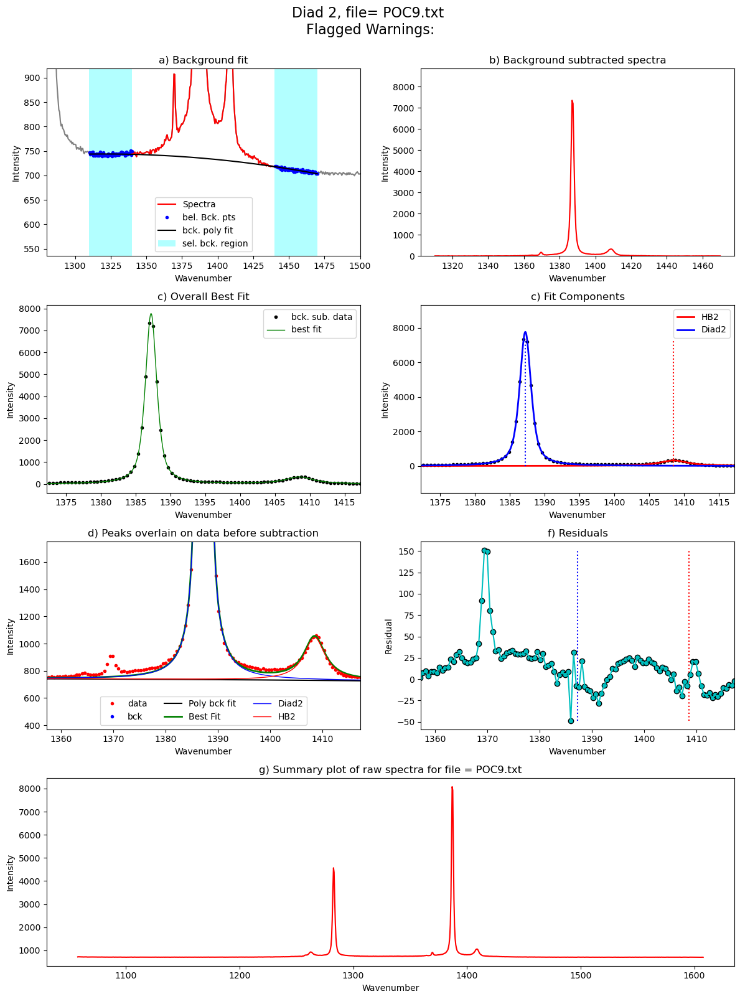

In [15]:
from tqdm import tqdm
plot_figure=True# If False, Means doesnt have to make figures, lot faster. 
close_figure=False # If True, wont show figures in notebook, but will still save them in a folder 
Diad_Files_i=Diad_Files
df_Merge = pd.DataFrame([])
for i in tqdm(range(0, len(Diad_Files))): #
    tqdm.write(f"Processing file: {Diad_Files[i]}")
    
    
    # For diad1, config file like you had in the previous. 
    # Only really used to exclude a range (say your spectra has a known spec)
    diad_id_config=pf.diad_id_config(exclude_range1=[1308, 1309])
    
    # Here, the prominence are taken from the fitting in the last notebook
    diad1_fit_config2.HB_prom=GroupN_df['HB1_abs_prom'].iloc[i]
    diad1_fit_config2.diad_prom=GroupN_df['Diad1_abs_prom'].iloc[i]
    diad1_fit_config2.gauss_amp=2*GroupN_df['HB1_abs_prom'].iloc[i]

    Diad1_fit=pf.fit_diad_1_w_bck(config1=diad1_fit_config2,
    config2=diad_id_config, path=spectra_path, filename=GroupN_df['filename'].iloc[i],
    filetype=filetype, plot_figure=plot_figure, close_figure=close_figure,
    Diad_pos=GroupN_df['Diad1_pos'].iloc[i],
    HB_pos=GroupN_df['HB1_pos'].iloc[i])

    ## Same for diad2, just also has a C13 peak
    diad2_fit_config_init.HB_prom=GroupN_df['HB2_abs_prom'].iloc[i]
    diad2_fit_config_init.diad_prom=GroupN_df['Diad2_abs_prom'].iloc[i]
    diad2_fit_config_init.gauss_amp= 2*GroupN_df['HB2_abs_prom'].iloc[i]
    diad2_fit_config_init.C13_prom=GroupN_df['C13_abs_prom'].iloc[i]
    
    
    Diad2_fit=pf.fit_diad_2_w_bck(config1=diad2_fit_config_init,
        config2=diad_id_config,
    path=spectra_path, filename=GroupN_df['filename'].iloc[i], 
    filetype=filetype,
    plot_figure=plot_figure, close_figure=close_figure,
    Diad_pos=GroupN_df['Diad2_pos'].iloc[i],
    HB_pos=GroupN_df['HB2_pos'].iloc[i], 
    C13_pos=GroupN_df['C13_pos'].iloc[i])
    
    # This combines the outputs into a single dataframe
    data=pf.combine_diad_outputs(filename=GroupN_df['filename'].iloc[i], prefix=prefix, 
    Diad1_fit=Diad1_fit, path=spectra_path,                  
    Diad2_fit=Diad2_fit)        
    
 

    df_Merge = pd.concat([df_Merge, data], axis=0).reset_index(drop=True)


In [ ]:
# Save parameters to excel
combo=df_Merge

if batch=='Weak':
    combo.to_excel('Weak_Diads.xlsx', index=False)
if batch=='Medium':
    combo.to_excel('Medium_Diads.xlsx', index=False)
if batch=='Strong':
    combo.to_excel('Strong_Diads.xlsx', index=False)

In [ ]:
combo

### This plays a sound - if you have a tendency  to procrastinate while notebooks are running

In [ ]:
# !pip install winotify

from winotify import Notification, audio

toast= Notification(app_id="VSCode",title="Notebook completed",
                    msg="Step3b_Secondary_Peaks is done!",
                    duration="short")
toast.set_audio(audio.Mail,loop=False)
toast.show()